In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl

# Load data

In [22]:
df = pd.read_pickle("../../data/interim/O1_data_processed.pkl")
df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy,30
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy,30
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy,30
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy,30
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy,30
...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.048000,-1.041500,-0.076500,1.4146,-5.6218,0.2926,E,row,medium,90
2019-01-20 17:33:27.200,-0.037000,-1.030333,-0.053333,-2.7684,-0.5854,2.2440,E,row,medium,90
2019-01-20 17:33:27.400,-0.060000,-1.031000,-0.082000,2.8416,-5.1342,-0.1220,E,row,medium,90


# Plot single columns

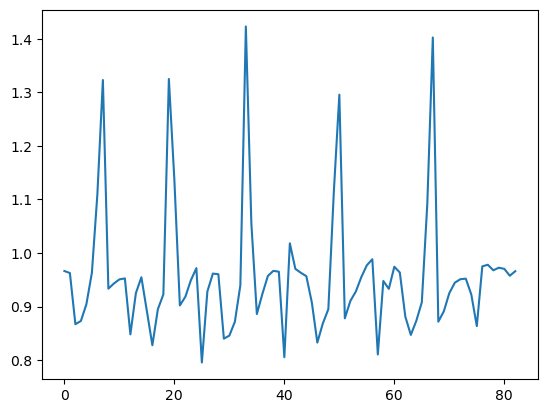

In [7]:
set_df = df[df["set"]== 1]
#plt.plot(set_df["acc_y"])
plt.plot(set_df["acc_y"].reset_index(drop=True))

# Plot all exercises

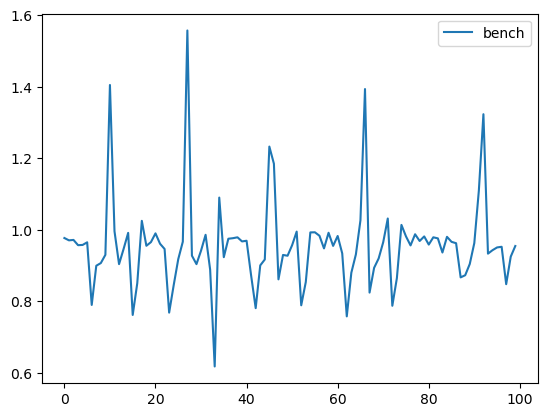

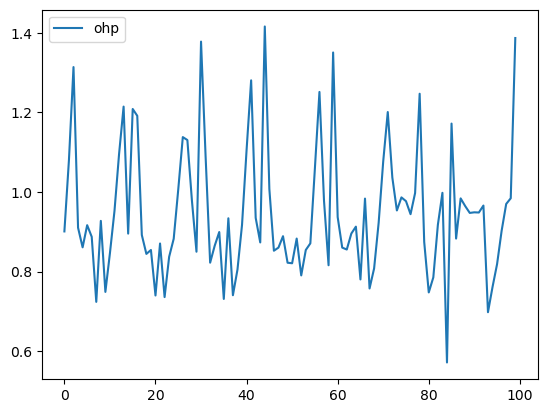

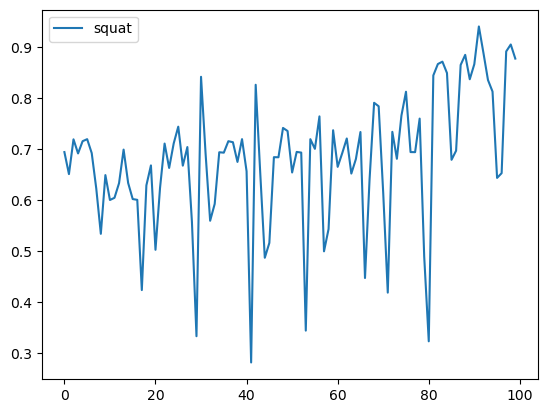

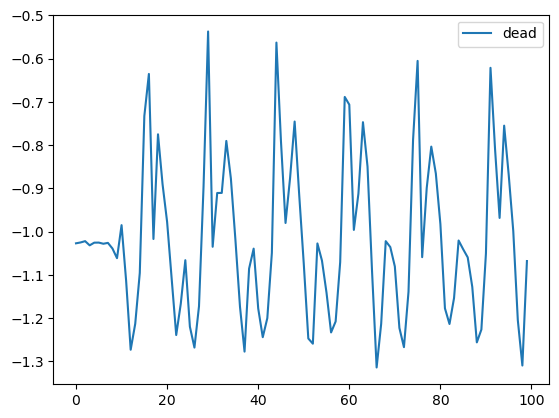

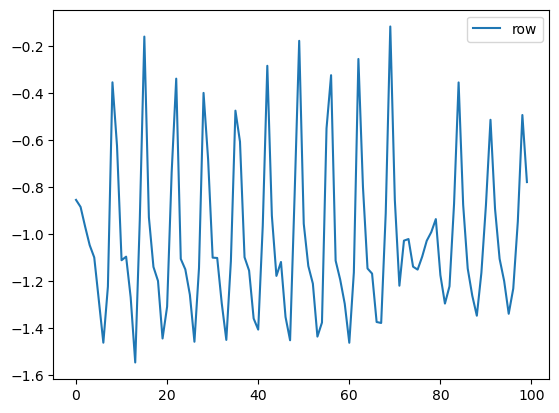

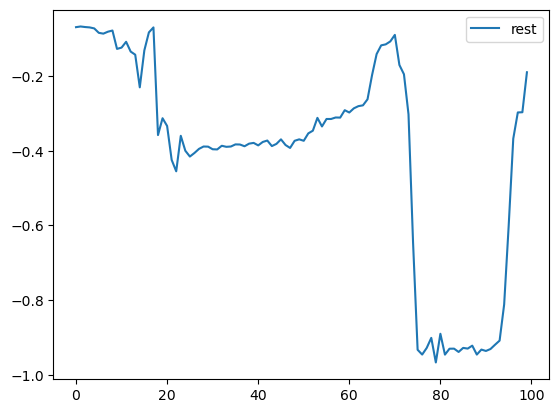

In [8]:
for label in df["label"].unique():
    subset = df[df["label"]==label]
    fig, axc = plt.subplots()
    plt.plot(subset[:100]["acc_y"].reset_index(drop=True), label= label)
    plt.legend()
    plt.show()

# Adjust plot settings

In [10]:
#mpl.style.use("seaborn-v0_8-deep")
mpl.rcParams['figure.figsize'] = (20, 5)
mpl.rcParams['figure.dpi'] = 100

# Compare medium vs. heavy sets

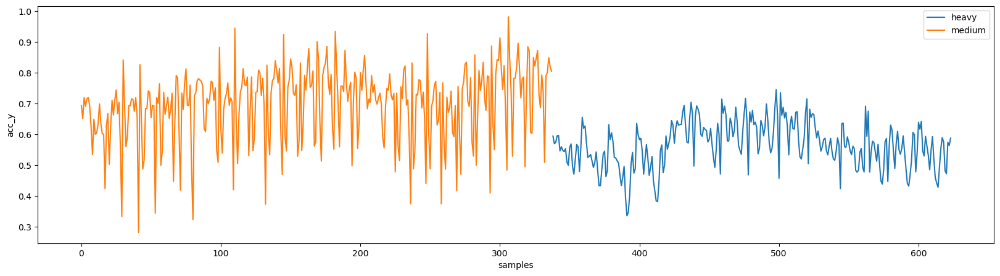

In [12]:
category_df = df.query("label == 'squat'").query("participant =='A'").reset_index()
fig, ax = plt.subplots()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
category_df.groupby(['category'])["acc_y"].plot()
plt.legend()

# Compare participants

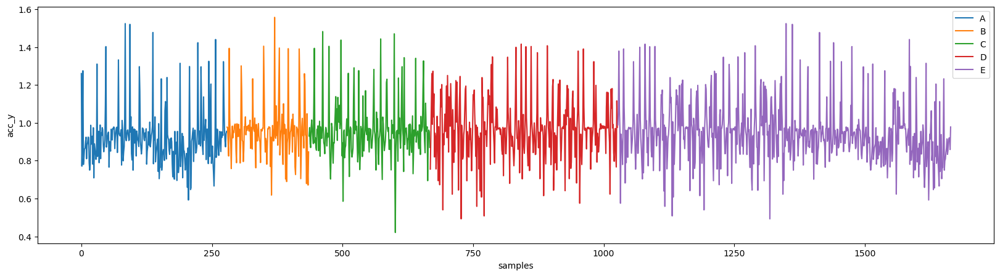

In [13]:
participant_df = df.query("label == 'bench'").sort_values("participant").reset_index()
fig, ax = plt.subplots()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
participant_df.groupby(['participant'])["acc_y"].plot()
plt.legend()

# Plot multiple axis

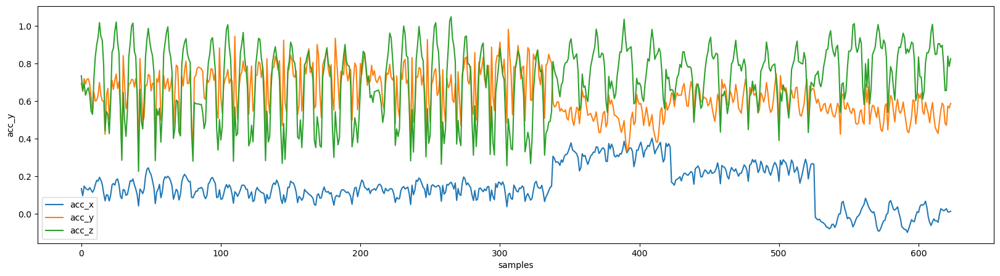

In [14]:
label = "squat"
participant = "A"
all_axis_df =(
    df.query(f"label == '{label}'")
    .query(f"participant == '{participant}'")
    .reset_index()
)

fig, ax = plt.subplots()
all_axis_df[["acc_x","acc_y","acc_z"]].plot(ax=ax)
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

# Create a loop to plot all combinations pour sensor

C:\Users\hp\AppData\Local\Temp\ipykernel_232\278012096.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


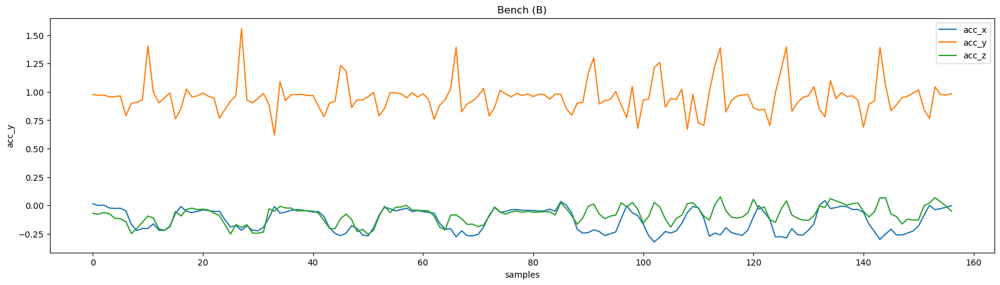

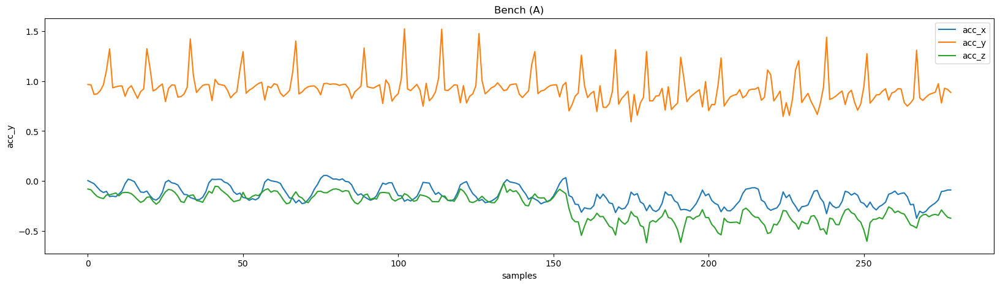

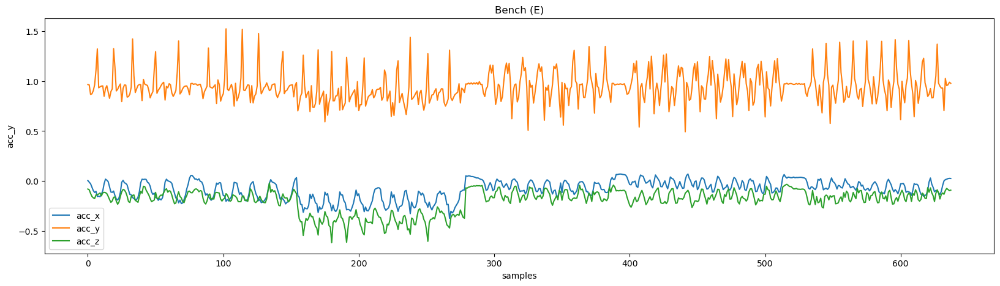

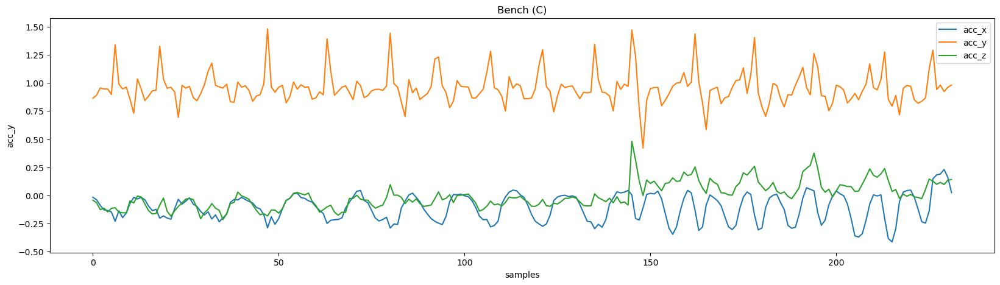

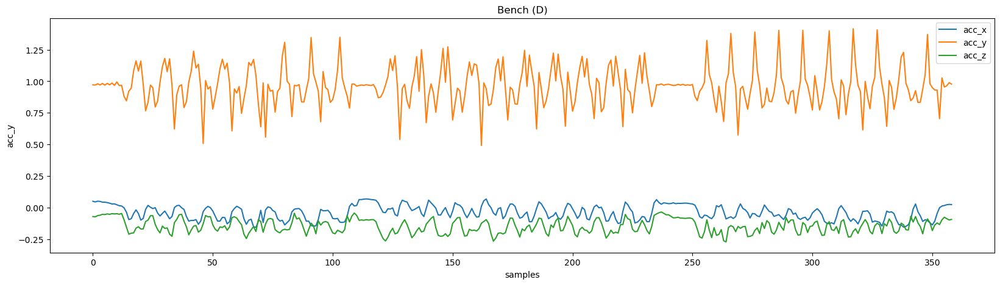

...

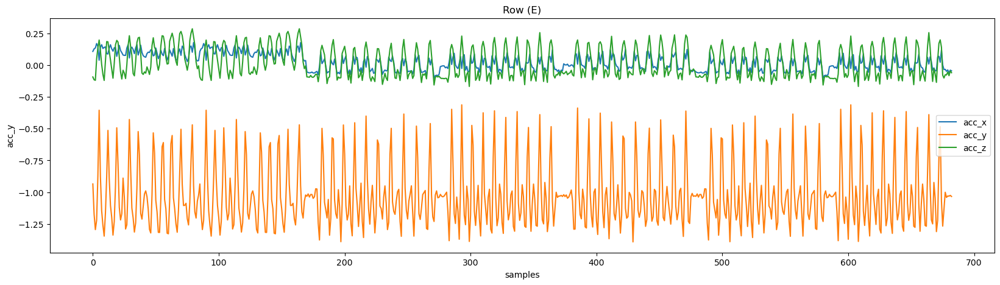

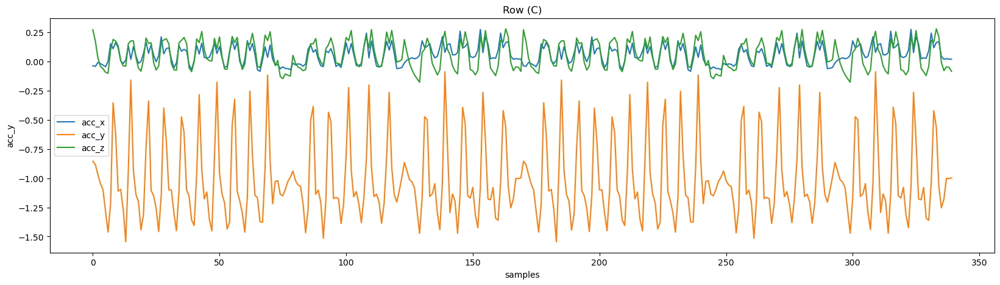

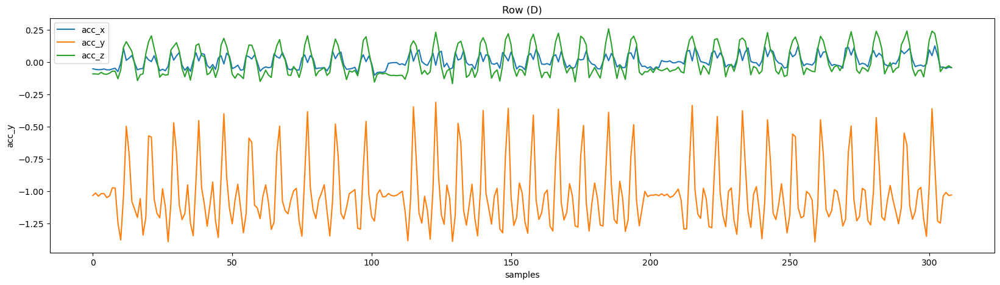

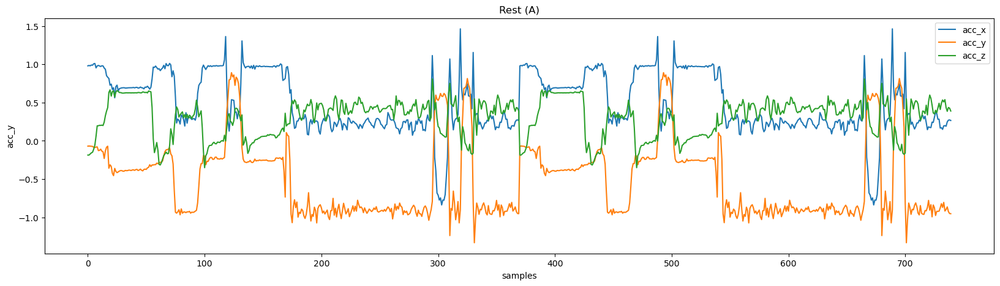

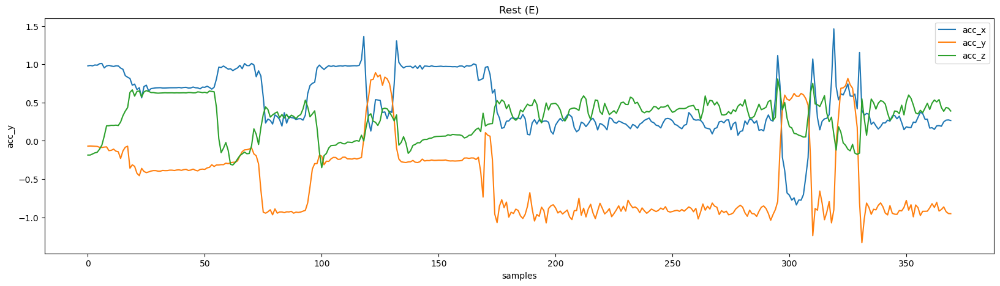

In [16]:
#Acceloremeter data
labels = df["label"].unique()
participants= df["participant"].unique()
for label in labels:
    for participant in participants:
        all_axis_df =(
        df.query(f"label == '{label}'")
        .query(f"participant == '{participant}'")
        .reset_index()
        )
        if len(all_axis_df)>0:
            
            fig, ax = plt.subplots()
            all_axis_df[["acc_x","acc_y","acc_z"]].plot(ax=ax)
            ax.set_ylabel("acc_y")
            ax.set_xlabel("samples")
            plt.title(f"{label} ({participant})".title())
            plt.legend()


C:\Users\hp\AppData\Local\Temp\ipykernel_232\393383606.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


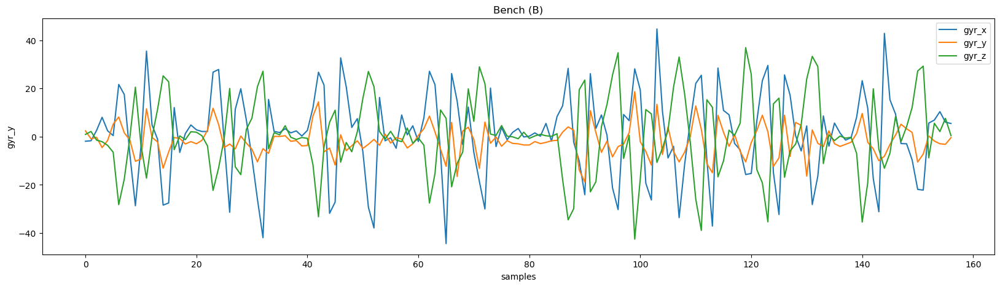

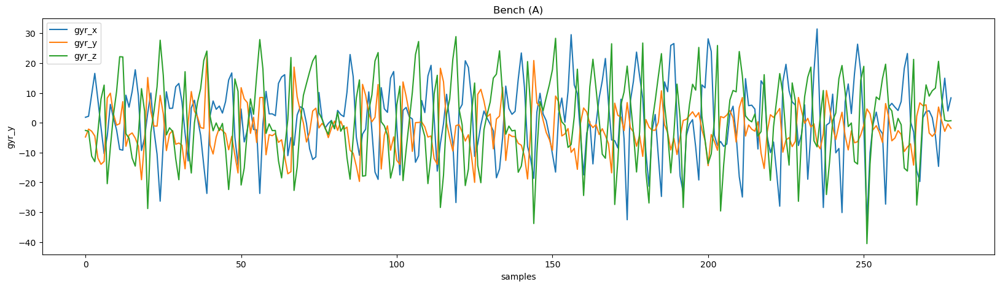

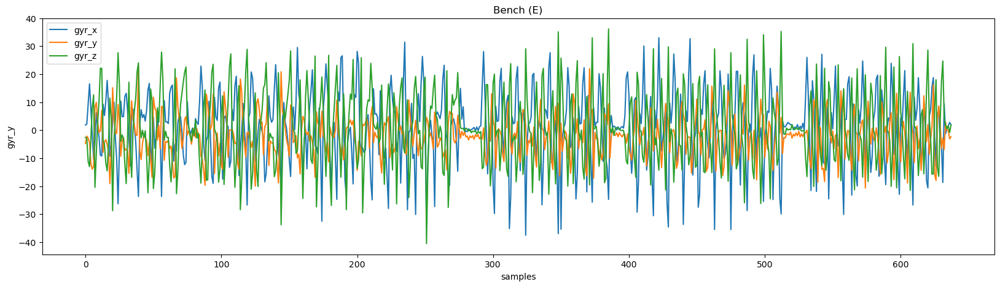

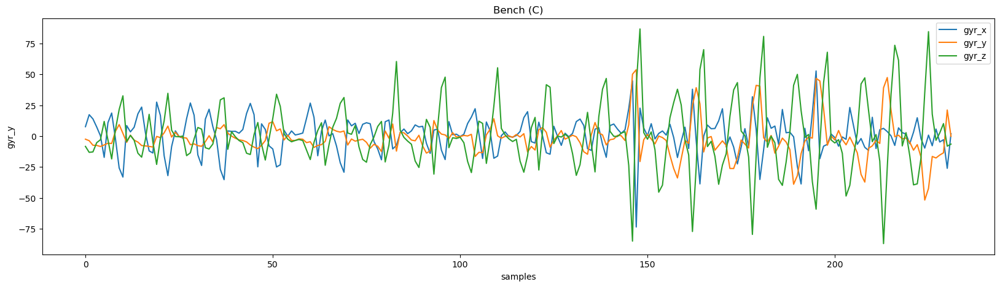

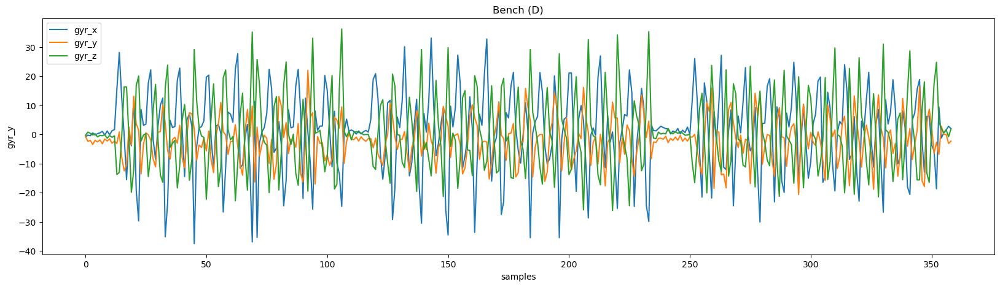

...

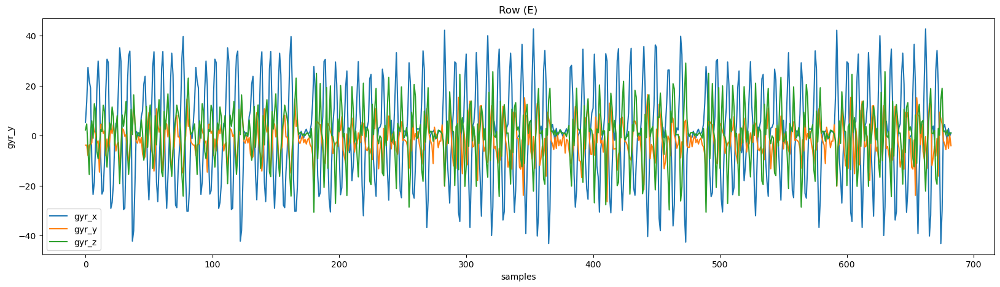

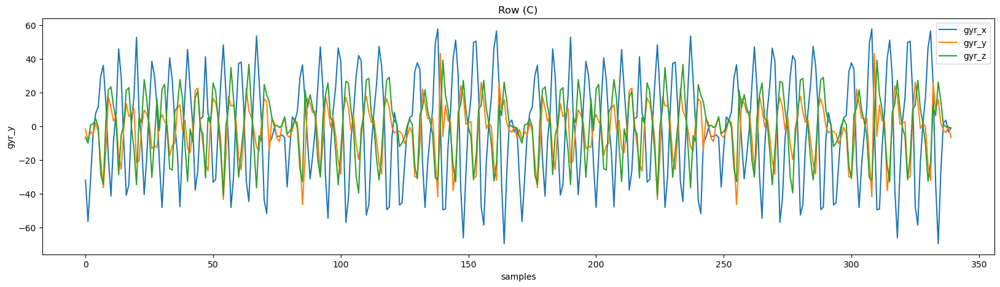

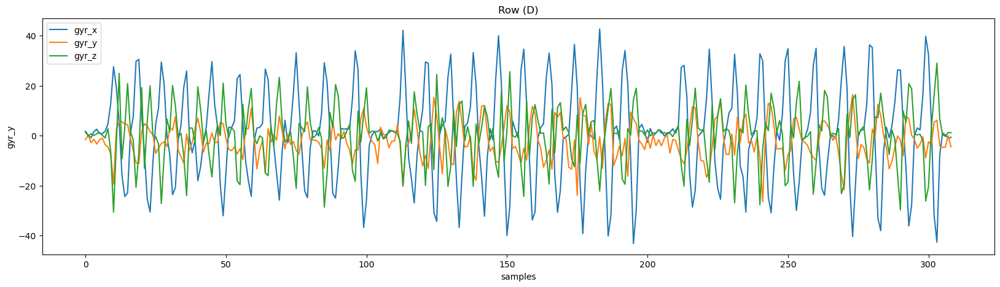

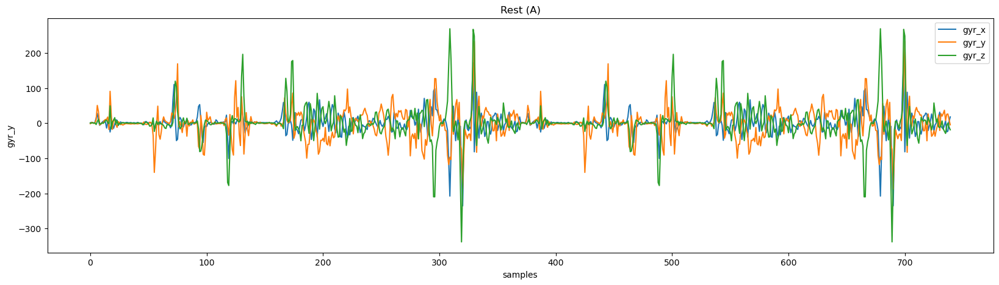

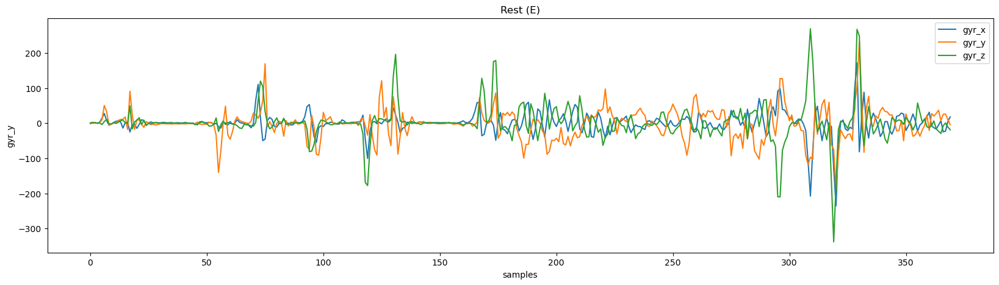

In [17]:
#Gyroscope data

for label in labels:
    for participant in participants:
        all_axis_df =(
        df.query(f"label == '{label}'")
        .query(f"participant == '{participant}'")
        .reset_index()
        )
        if len(all_axis_df)>0:
            
            fig, ax = plt.subplots()
            all_axis_df[["gyr_x","gyr_y","gyr_z"]].plot(ax=ax)
            ax.set_ylabel("gyr_y")
            ax.set_xlabel("samples")
            plt.title(f"{label} ({participant})".title())
            plt.legend()

# Combine plots in one figure


Text(0.5, 0, 'samples')

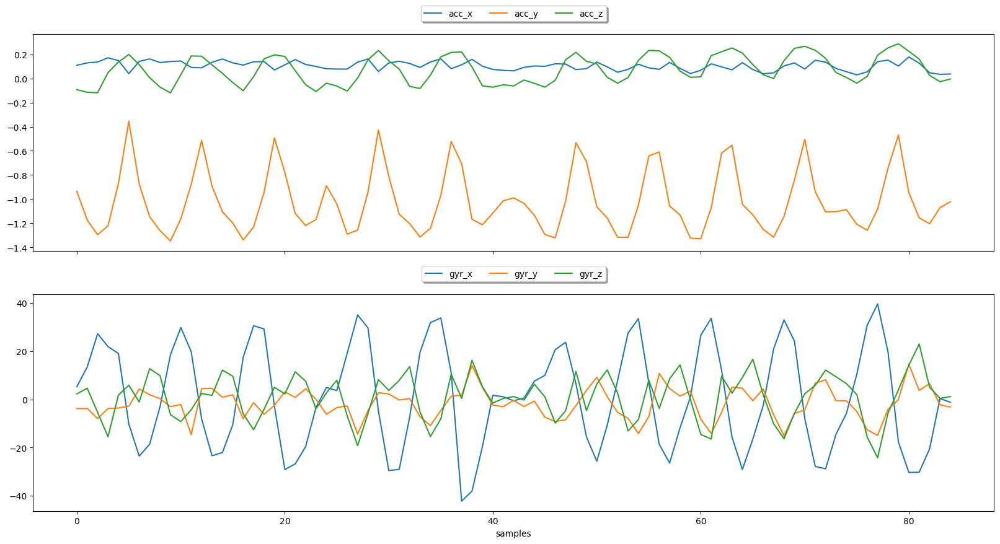

In [20]:
label = "row"
participant = "A"
combined_plot_df =(
    df.query(f"label == '{label}'")
    .query(f"participant == '{participant}'")
    .reset_index(drop=True)
)

fig, ax = plt.subplots(nrows=2, sharex= True, figsize =(20,10))
combined_plot_df[["acc_x","acc_y","acc_z"]].plot(ax=ax[0])
combined_plot_df[["gyr_x","gyr_y","gyr_z"]].plot(ax=ax[1])

ax[0].legend(loc= "upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox= True, shadow = True)
ax[1].legend(loc= "upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox= True, shadow = True)
ax[1].set_xlabel("samples")

# Loop over all combinations and export for both sensors

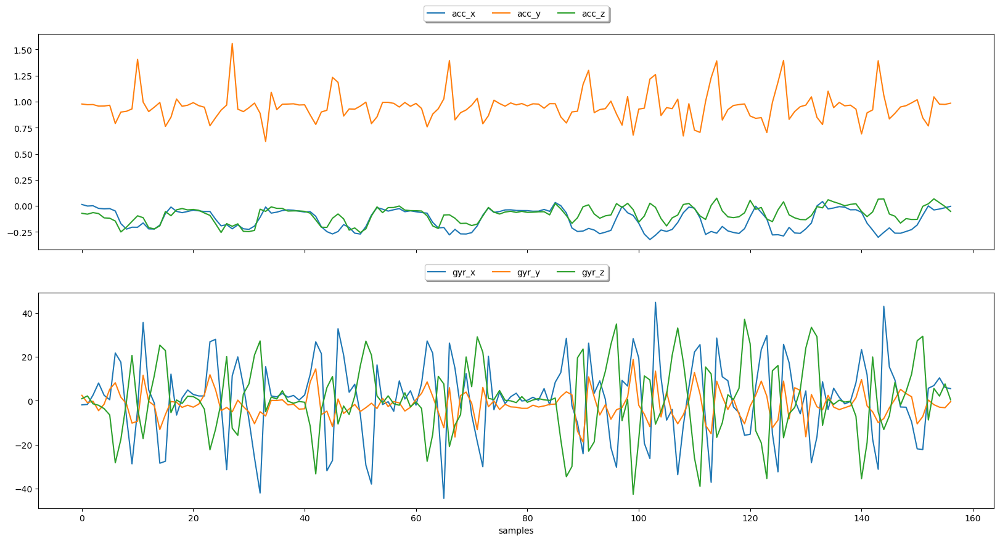

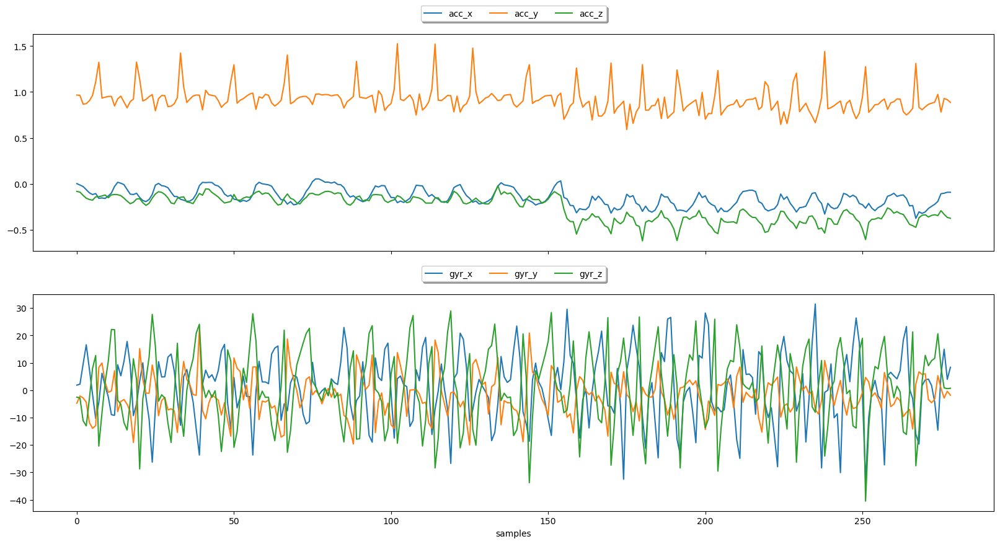

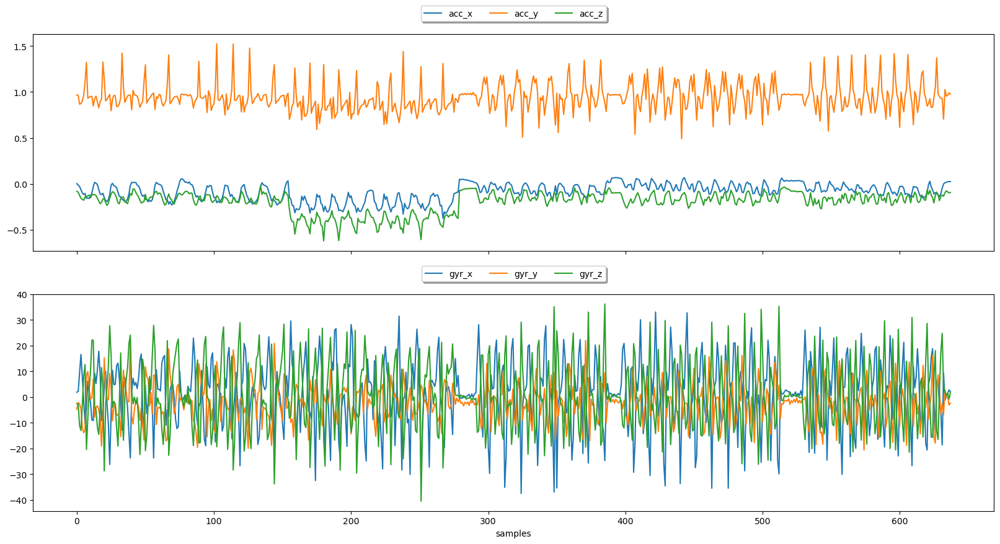

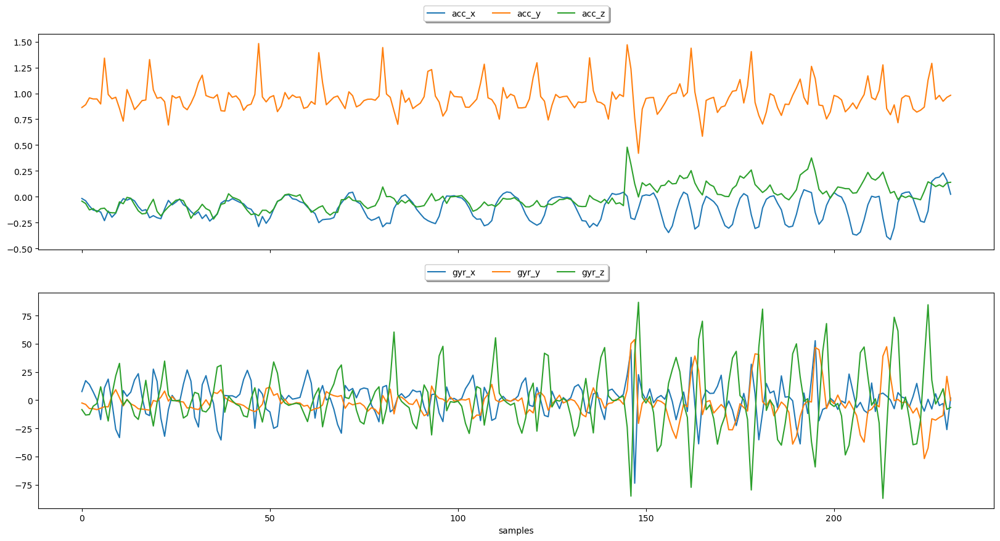

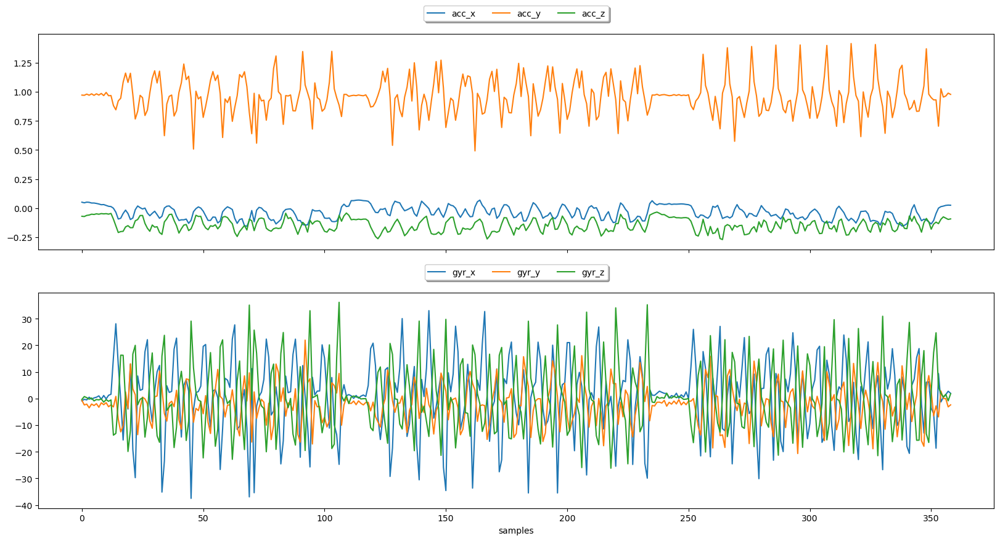

...

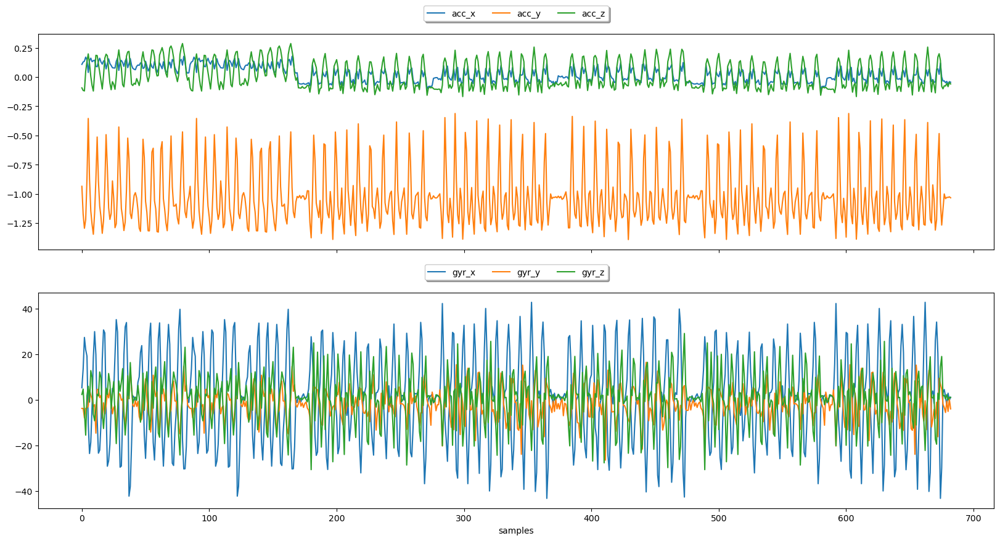

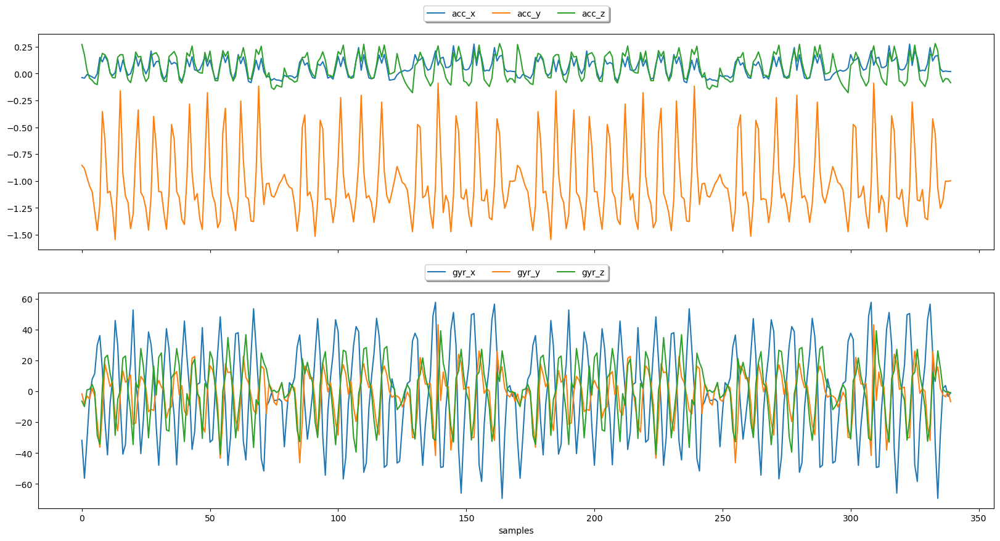

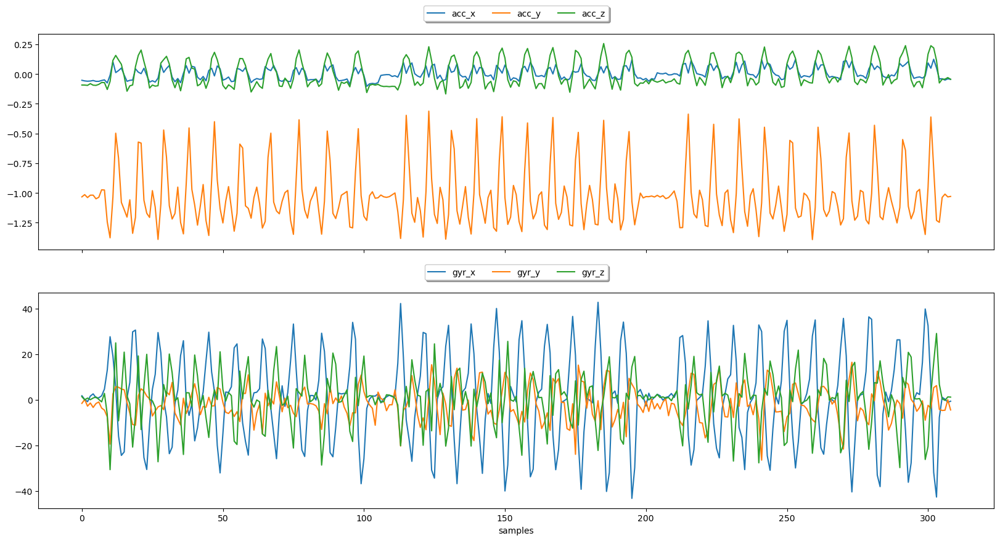

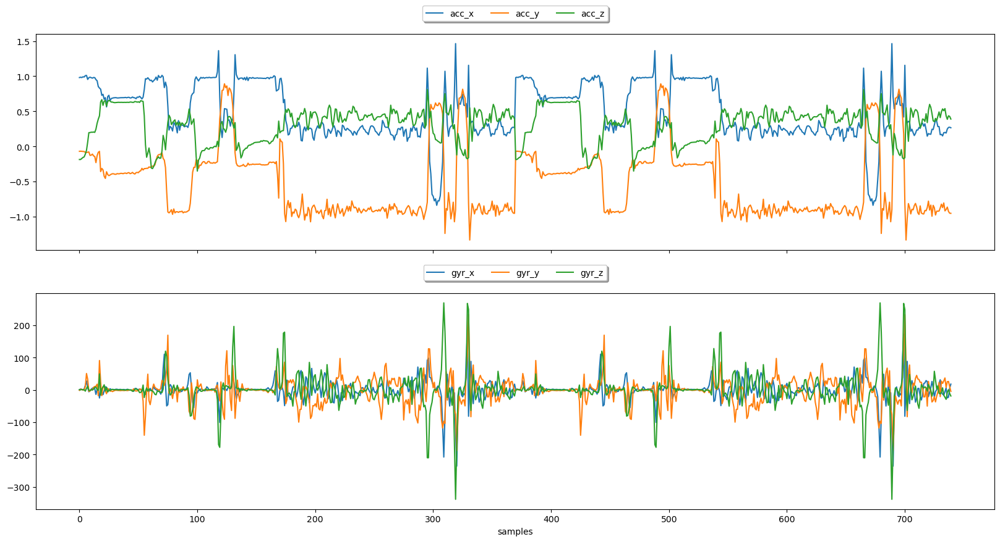

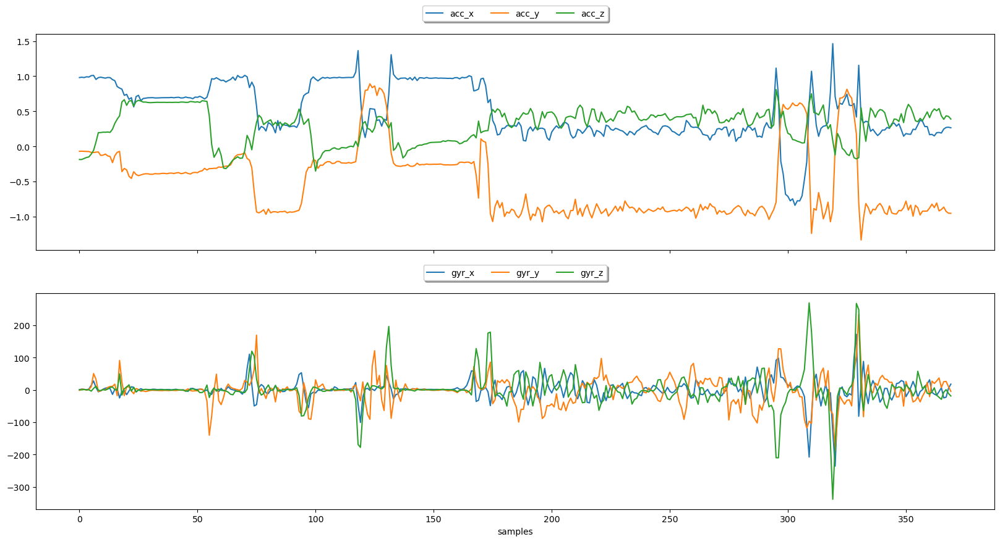

In [21]:
labels = df["label"].unique()
participants= df["participant"].unique()

for label in labels:
    for participant in participants:
        combined_plot_df =(
        df.query(f"label == '{label}'")
        .query(f"participant == '{participant}'")
        .reset_index()
        )
        if len(combined_plot_df)>0:
            fig, ax = plt.subplots(nrows=2, sharex= True, figsize =(20,10))

            combined_plot_df[["acc_x","acc_y","acc_z"]].plot(ax=ax[0])
            combined_plot_df[["gyr_x","gyr_y","gyr_z"]].plot(ax=ax[1])

            ax[0].legend(loc= "upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox= True, shadow = True)
            ax[1].legend(loc= "upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox= True, shadow = True)
            ax[1].set_xlabel("samples")
            plt.savefig(f"../../reports/figures/{label.title()} ({participant}).png")
            plt.show()